# Planning and Notes

Though the user provides 95% of the information about the positioning of each image, there is still fineness that can be best achieved through software.

I'll be using the term 'stack' to represent the layered images, and 'pixel stack' to represent a stack of aligned pixels from different images.

We will use vectors $\vec{i}$ and $\vec{j}$ to represent the chosen translations, one XY translation per image (EG the pixel of the k'th image, $I_k$, which appears at the real location $\langle x, y\rangle$, is $I_k\langle x - i_k, y - j_k\rangle$).We can use $\vec{i_e}$ and $\vec{j_e}$ to specify an estimate for the translations, and $\vec{i_g}$ and $\vec{j_g}$ for the optimal values ('ground truth').

We will use $S$ to represent a particular pixel stack, $S_n$ to represent a particular image's pixel in that stack, and $|S|$ to represent the height of that pixel stack.

The variance $\sigma^2(S)$ of one pixel stack is given by
$$ \sigma^2(S) = \frac{\sum_{n=0}^{|S|} (S_n - \bar{S})^2}{|S| - 1}$$

The general goal is to select a set of transforms $\langle \vec{i}, \vec{j} \rangle$ which minimizes the sum of the variances of each resulting pixel. 

We can also select a single 2D array $M$ which acts as an 'alpha mask' over untransformed pixels, weakening or eliminating their contribution to the variance and the final image.

# Approaches

A terrible approach would be to calculate the variance for every $\langle i, j \rangle \in \mathbb{Z^2}$ and pick the best one. However, we have with us the aid of a willing human mind to give us an exceptionally good approximation of the perfect $\langle i, j \rangle$, and we just need to refine it. For now, let's assume the human has given us both an approximate $\langle i, j \rangle$ for each image, and some radius $R$ around each of those transformations in which the best solution must lie.

Because $\nabla\sigma^2\langle i, j\rangle$ is only sometimes continuous, gradient descent processes may be largely difficult until we're exceptionally close to the correct answer.

We may be able to downsample our images to reduce calculation time on relatively coarse adjustments.

# Failure States

1. Random Noise
2. Tesselated patterns without any features
3. Uniformly distributed instances of similar features.
4. Significant blurriness in the images.

# Gradient Descent

If we assume our images have some kind of average feature size $f$ (as a radius in pixels), and if $(\vec{i_e}-\vec{i_g})^2 + (\vec{j_e} - \vec{j_g})^2 < f^2$, $\nabla\sigma^2\langle i, j\rangle$ has a meaningful value and can be used. If we assume $(\vec{i_e}-\vec{i_g})^2 + (\vec{j_e} - \vec{j_g})^2 < R^2$ (which is the purpose of R), and we assume our helpful human has given us a prior prediction and radius such that $R < f$, then we can use stepped gradient descent algorithms to find an optimal solution.

### Pros:
1. This is largely the algorithm humans make use of, starting with larger features and progressing to smaller ones.
2. The path of the search algorithm is essentially a 1D series of steps through the image, which is a very small computational space.

### Cons:
1. This comes with some significant assumptions.
2. The expected boundary on the search size goes up with the feature radius (a longer search for a higher resolution image; a longer search if the features are large, blurred by a fraction of their size, and R is accordingly high).

# Downsampling

It's significantly likely that our image has far more than one pixel per feature ($f > 1$). If $f$ is significantly larger than 1 - say, 2 - then we should be able to save time by downsizing our image by a factor of two, performing whatever search we chose, then transforming our results onto the higher resolution image and continuing to refine the search.

# Feature Sizes and the Fourier Transform

We can find significant information in the Fourier transform of each of our images. An example image is included below, along with it's fourier transformation:

### This is 'Test A', an image through a microscope.
<div>
    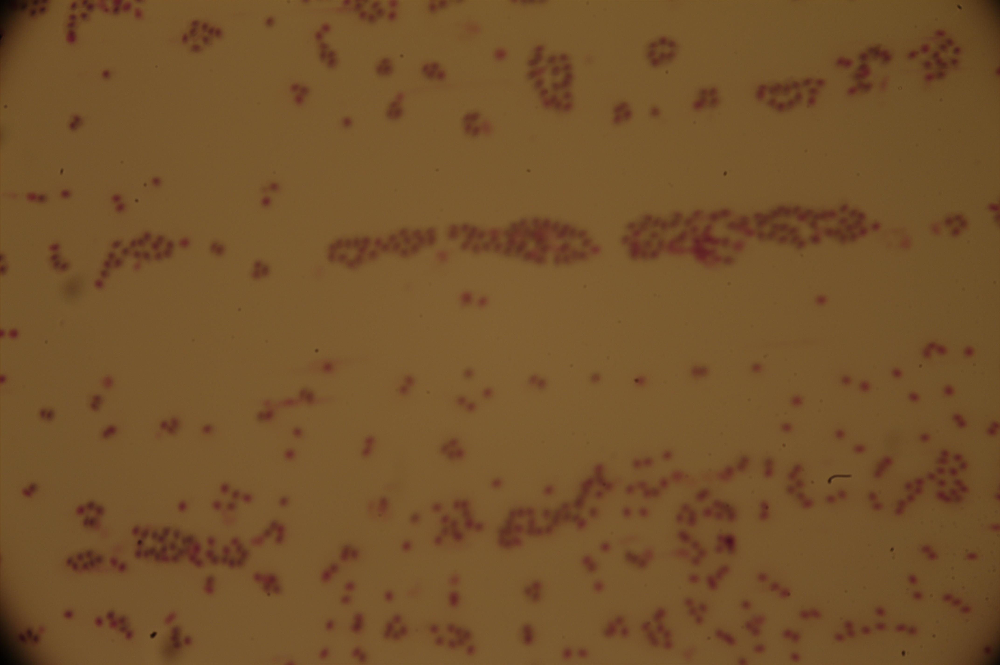
</div>

### This is the Fourier Transform of Test A:
<div>
    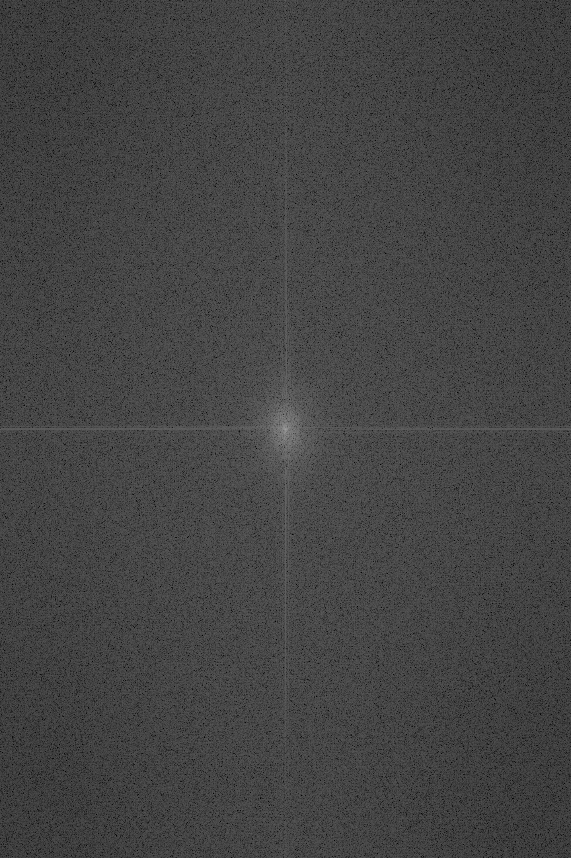
</div>

### This is a section of Test A,
blown up 4x and cropped to a region in the middle:
<div>
    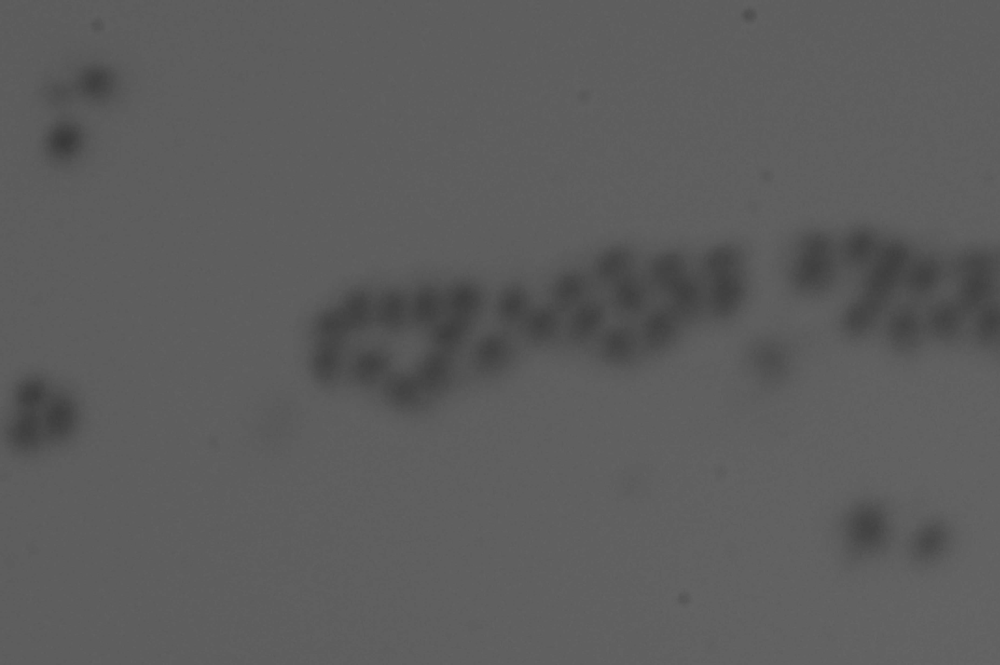
</div>

### And this is the Fourier Transform of this 4x-zoomed section:
<div>
    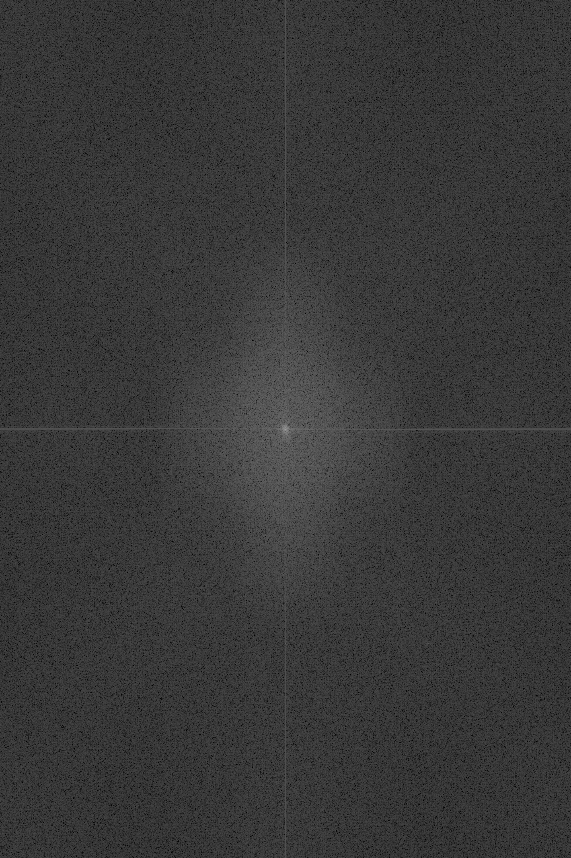
</div>

Notice how the 'bright' region in the 4x-zoomed FFT is significantly larger than in the original's FFT. Notice also that the 'features' are 4x larger in the zoomed image. This shows that an FFT can give us valuable information about the size of features in an image by:
1. Removing background noise (easy, the images are log-scaled representations of the actual values).
2. Calculating the brightness-weighted average distance to the center
3. Determine a relationship between this variance and actual feature scale

We can then use this feature scale to guide our downsampling optimizations.

# Gradient Descent Process

We will assume that there is only one optimal soluion for $\langle \vec{i}, \vec{j} \rangle$ - this rests on the nature of the use case, and excludes the possibility of tiled features. This means that, if all $i_{!n}$ are at their correct values, there will only be one optimal value for $i_n$ (and same for $j$). Notice - if some values of $i$ are incorrect and are held fixed, there will be some global minima among the unfixed values of $i$, but it may not be the correct value.

Because there is only one solution for $i_n$ when all $i_{!n}$ are solved, we can iteratively approach the problem by finding values of $i_n$ in sequence, using the prior solutions to provide more information for later values. In other words, we are guaranteed to lose nothing by making use of a greedy algorithm.

The simplest approach in my mind is to calculate the variances for each cardinal direction and wherever our current $\langle \vec{i}, \vec{j} \rangle$ is, and step towards whichever one is least. If the current $\langle \vec{i}, \vec{j} \rangle$ is least, we expand our search - if we find a better place to investigate, we move there. If not, we upsample and continue searching. When we finish searching our optimal resolution, we mark that image as optimized and move on to the next one.

